In [ ]:
import statsmodels.api as sm
import pandas as pd
import seaborn as sns
sns.set()
from week2_helpers import variance_inflation_factor

In [ ]:
# Read the two CSV files
df_youtube = pd.read_csv('/content/unicef_youtube.csv')
df_indexer = pd.read_csv('/content/unicef_indexer.csv')

# Merge the two CSV files together based on "video IDs" columns
df_merge = df_youtube.merge(df_indexer, left_on = "video_id", right_on = "id")

# Remove unnecessary columns
df_merge = df_merge.drop(columns=["id", "video_id", "url"], axis=1)

# Drop Videos without "likes" information
df_merge = df_merge.dropna(subset=["likes"])

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:

# Get Videos before & after 2013. Note that .astype(int) converts the year from STRING to INTEGER.
videos_before_2013 = df_merge[df_merge["date_published_year"].astype(int) < 2013]
videos_after_2013 = df_merge[df_merge["date_published_year"].astype(int) >= 2013]

In [ ]:
videos_before_2013.head(3)

,genre,height,is_family_friendly,likes,width,tags_length,title_entities_unicef,title_entities_haiti,title_entities_pakistan,title_entities_congo,title_entities_syrian,title_entities_dr,title_entities_ethiopia,title_entities_somalia,title_entities_afghanistan,title_entities_syria,title_entities_kenya,title_entities_gaza,title_entities_2,title_entities_niger,title_entities_unicef_executive,title_entities_un,title_entities_unicef_executive_board,title_entities_myanmar,title_entities_mia_farrow,title_entities_executive_board,title_entities_india,title_entities_lebanon,title_entities_palestinian,title_entities_philippines,title_entities_chad,title_entities_uganda,title_entities_bangladesh,title_entities_africa,title_entities_zimbabwe,title_entities_first,title_entities_mali,title_entities_5,title_entities_iraq,title_entities_south_sudan,...,indexer_ocr_unicefotelevision_area,indexer_ocr_mother_area,indexer_ocr_www.unicef.org_area,indexer_ocr_children_area,indexer_ocr_for_every_child_area,indexer_ocr_unicefg@_area,indexer_ocr_unicef_executive_director_area,indexer_ocr_allchiidren_area,indexer_ocr_rights_area,indexer_ocr_for_children_area,indexer_ocr_share_this_video_area,indexer_ocr_advance_humanity_area,indexer_ocr_theoneminutesjr._area,indexer_ocr_1946-2006_area,indexer_ocr_unicef_goodwill_ambassador_area,indexer_ocr_all_area,indexer_ocr_and_area,indexer_ocr_for_area,indexer_ocr_unicefo_television_area,indexer_ocr_unicef(ò)g_area,indexer_ocr_to_area,indexer_ocr_unicefg@_for_every_child_area,indexer_ocr_unicefoteievision_area,indexer_ocr_unicef&_television_area,indexer_ocr_student_area,indexer_ocr_unicef@org_area,"indexer_ocr_health,_education,_equality,_protection_area",indexer_ocr_unicef.org/rightsite_area,indexer_ocr_unicefo)_area,indexer_ocr_ann_m._veneman_area,indexer_ocr_the_area,indexer_ocr_anthony_lake_area,indexer_ocr_unice_area,indexer_ocr_teacher_area,indexer_ocr_director_area,indexer_ocr_president_area,indexer_ocr_unicef(û)g_area,indexer_num_faces,indexer_num_shots,indexer_statistics_correspondence_count
0,Nonprofits & Activism,720,True,2.0,1280,7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,82626,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,15,2
3,Nonprofits & Activism,720,True,2.0,1280,7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7,0
4,Nonprofits & Activism,360,True,17.0,480,10,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,21,22,0
5,Nonprofits & Activism,360,True,19.0,480,8,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,12,30,0
6,Nonprofits & Activism,360,True,6.0,640,12,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1156,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,10400,0,0,0,0,0,0,0,0,8,52,0


In [ ]:
videos_after_2013.head(3)

,genre,height,is_family_friendly,likes,width,tags_length,title_entities_unicef,title_entities_haiti,title_entities_pakistan,title_entities_congo,title_entities_syrian,title_entities_dr,title_entities_ethiopia,title_entities_somalia,title_entities_afghanistan,title_entities_syria,title_entities_kenya,title_entities_gaza,title_entities_2,title_entities_niger,title_entities_unicef_executive,title_entities_un,title_entities_unicef_executive_board,title_entities_myanmar,title_entities_mia_farrow,title_entities_executive_board,title_entities_india,title_entities_lebanon,title_entities_palestinian,title_entities_philippines,title_entities_chad,title_entities_uganda,title_entities_bangladesh,title_entities_africa,title_entities_zimbabwe,title_entities_first,title_entities_mali,title_entities_5,title_entities_iraq,title_entities_south_sudan,...,indexer_ocr_unicefotelevision_area,indexer_ocr_mother_area,indexer_ocr_www.unicef.org_area,indexer_ocr_children_area,indexer_ocr_for_every_child_area,indexer_ocr_unicefg@_area,indexer_ocr_unicef_executive_director_area,indexer_ocr_allchiidren_area,indexer_ocr_rights_area,indexer_ocr_for_children_area,indexer_ocr_share_this_video_area,indexer_ocr_advance_humanity_area,indexer_ocr_theoneminutesjr._area,indexer_ocr_1946-2006_area,indexer_ocr_unicef_goodwill_ambassador_area,indexer_ocr_all_area,indexer_ocr_and_area,indexer_ocr_for_area,indexer_ocr_unicefo_television_area,indexer_ocr_unicef(ò)g_area,indexer_ocr_to_area,indexer_ocr_unicefg@_for_every_child_area,indexer_ocr_unicefoteievision_area,indexer_ocr_unicef&_television_area,indexer_ocr_student_area,indexer_ocr_unicef@org_area,"indexer_ocr_health,_education,_equality,_protection_area",indexer_ocr_unicef.org/rightsite_area,indexer_ocr_unicefo)_area,indexer_ocr_ann_m._veneman_area,indexer_ocr_the_area,indexer_ocr_anthony_lake_area,indexer_ocr_unice_area,indexer_ocr_teacher_area,indexer_ocr_director_area,indexer_ocr_president_area,indexer_ocr_unicef(û)g_area,indexer_num_faces,indexer_num_shots,indexer_statistics_correspondence_count
1,Nonprofits & Activism,720,True,898.0,1280,8,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,19885,0,0,0,0,0,0,5661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,7,26,3
11,Nonprofits & Activism,720,True,23.0,1280,35,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,27,3
16,Nonprofits & Activism,720,True,86.0,1280,28,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,50055,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,18,1


In [ ]:
columns = ['genre', 'indexer_source_language', 'date_published_year', 'date_published_month', 'date_published_day']
df_videos_after_2013=pd.get_dummies(videos_after_2013, columns=columns, drop_first=True)

df_videos_before_2013=pd.get_dummies(videos_before_2013, columns=columns, drop_first=True)


In [ ]:
df_videos_after_2013.shape

(994, 513)

In [ ]:
Y_videos_before_2013=df_videos_before_2013['likes']
X_videos_before_2013=df_videos_before_2013.drop(['likes'], axis=1).astype(float)


Y_videos_after_2013=df_videos_after_2013['likes']
X_videos_after_2013=df_videos_after_2013.drop(['likes'], axis=1).astype(float)



In [ ]:
from statsmodels.api import add_constant

In [ ]:
X_videos_after_2013=sm.add_constant(X_videos_after_2013, has_constant='add')

In [ ]:
X_videos_after_2013.shape

(994, 513)

In [ ]:
X_videos_after_2013

,const,height,is_family_friendly,width,tags_length,title_entities_unicef,title_entities_haiti,title_entities_pakistan,title_entities_congo,title_entities_syrian,title_entities_dr,title_entities_ethiopia,title_entities_somalia,title_entities_afghanistan,title_entities_syria,title_entities_kenya,title_entities_gaza,title_entities_2,title_entities_niger,title_entities_unicef_executive,title_entities_un,title_entities_unicef_executive_board,title_entities_myanmar,title_entities_mia_farrow,title_entities_executive_board,title_entities_india,title_entities_lebanon,title_entities_palestinian,title_entities_philippines,title_entities_chad,title_entities_uganda,title_entities_bangladesh,title_entities_africa,title_entities_zimbabwe,title_entities_first,title_entities_mali,title_entities_5,title_entities_iraq,title_entities_south_sudan,title_entities_nigeria,...,date_published_month_3,date_published_month_4,date_published_month_5,date_published_month_6,date_published_month_7,date_published_month_8,date_published_month_9,date_published_month_10,date_published_month_11,date_published_month_12,date_published_day_2,date_published_day_3,date_published_day_4,date_published_day_5,date_published_day_6,date_published_day_7,date_published_day_8,date_published_day_9,date_published_day_10,date_published_day_11,date_published_day_12,date_published_day_13,date_published_day_14,date_published_day_15,date_published_day_16,date_published_day_17,date_published_day_18,date_published_day_19,date_published_day_20,date_published_day_21,date_published_day_22,date_published_day_23,date_published_day_24,date_published_day_25,date_published_day_26,date_published_day_27,date_published_day_28,date_published_day_29,date_published_day_30,date_published_day_31
1,1.0,720.0,1.0,1280.0,8.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11,1.0,720.0,1.0,1280.0,35.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16,1.0,720.0,1.0,1280.0,28.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18,1.0,720.0,1.0,1280.0,15.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32,1.0,360.0,1.0,640.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3955,1.0,720.0,1.0,1280.0,18.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [ ]:
X_videos_before_2013=sm.add_constant(X_videos_before_2013,has_constant='add')


In [ ]:
X_videos_before_2013.shape

(2874, 524)

Fit the model

In [ ]:
model_before_2013=sm.OLS(Y_videos_before_2013, X_videos_before_2013)
results_before_2013=model_before_2013.fit()

In [ ]:
model_after_2013=sm.OLS(Y_videos_after_2013, X_videos_after_2013)
results_after_2013=model_after_2013.fit()

# VIF values for each column, and drop columns with their VIF > 5

In [ ]:
vif1 = variance_inflation_factor(X_videos_after_2013)
vif2=variance_inflation_factor(X_videos_before_2013)

In [ ]:
df_coeffs_before_2013 = pd.DataFrame({"Coefficients": results_before_2013.params, "p": results_before_2013.pvalues, "vif": vif2["vif"]})
df_coeffs_before_2013 = df_coeffs_before_2013.drop("const", axis=0)
df_coeffs_before_2013_sorted = df_coeffs_before_2013.reindex(df_coeffs_before_2013["p"].sort_values().index)
df_coeffs_before_2013_sorted.style.bar(subset = ["Coefficients", "p", "vif"], align='mid', color=['#d65f5f', '#5fba7d'])
df_videos_before_2013_vif=X_videos_before_2013.loc[:,vif2['vif']<=5]

In [ ]:
df_coeffs_after_2013 = pd.DataFrame({"Coefficients": results_after_2013.params, "p": results_after_2013.pvalues, "vif": vif2["vif"]})
df_coeffs_after_2013 = df_coeffs_after_2013.drop("const", axis=0)
df_coeffs_after_2013_sorted = df_coeffs_after_2013.reindex(df_coeffs_after_2013["p"].sort_values().index)
df_coeffs_after_2013_sorted.style.bar(subset = ["Coefficients", "p", "vif"], align='mid', color=['#d65f5f', '#5fba7d'])
df_videos_after_2013_vif=X_videos_after_2013.loc[:,vif1['vif']<=5]

In [ ]:
Y_videos_before_2013 = df_videos_before_2013["likes"]
X_videos_before_2013 = sm.add_constant(df_videos_before_2013_vif.astype(float), has_constant='add')

model_before_2013_vif = sm.OLS(Y_videos_before_2013, X_videos_before_2013)
results_before_2013_vif = model_before_2013_vif.fit()
print(results_before_2013_vif.summary())


                            OLS Regression Results                            
Dep. Variable:                  likes   R-squared:                       0.413
Model:                            OLS   Adj. R-squared:                  0.304
Method:                 Least Squares   F-statistic:                     3.765
Date:                Sun, 21 Jun 2020   Prob (F-statistic):           6.81e-98
Time:                        05:31:50   Log-Likelihood:                -16127.
No. Observations:                2874   AIC:                         3.316e+04
Df Residuals:                    2420   BIC:                         3.587e+04
Df Model:                         453                                         
Covariance Type:            nonrobust                                         
                                                                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------

In [ ]:
Y_videos_after_2013 = df_videos_after_2013["likes"]
X_videos_after_2013 = sm.add_constant(df_videos_after_2013_vif.astype(float), has_constant='add')

model_after_2013_vif = sm.OLS(Y_videos_after_2013, X_videos_after_2013)
results_after_2013_vif = model_after_2013_vif.fit()
print(results_after_2013_vif.summary())


                            OLS Regression Results                            
Dep. Variable:                  likes   R-squared:                       0.248
Model:                            OLS   Adj. R-squared:                 -0.098
Method:                 Least Squares   F-statistic:                    0.7176
Date:                Sun, 21 Jun 2020   Prob (F-statistic):               1.00
Time:                        05:33:04   Log-Likelihood:                -7805.5
No. Observations:                 994   AIC:                         1.624e+04
Df Residuals:                     680   BIC:                         1.778e+04
Df Model:                         313                                         
Covariance Type:            nonrobust                                         
                                                                            coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------

In [ ]:
before_sginificant=results_before_2013.pvalues< 0.05
print(before_sginificant.sum())
before_significant_vif=results_before_2013_vif.pvalues  < 0.05
print(before_significant_vif.sum())

47
39


In [ ]:
after_sginificant=results_after_2013.pvalues< 0.05
print(after_sginificant.sum())
after_significant_vif=results_after_2013_vif.pvalues  < 0.05
print(after_significant_vif.sum())

16
9


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


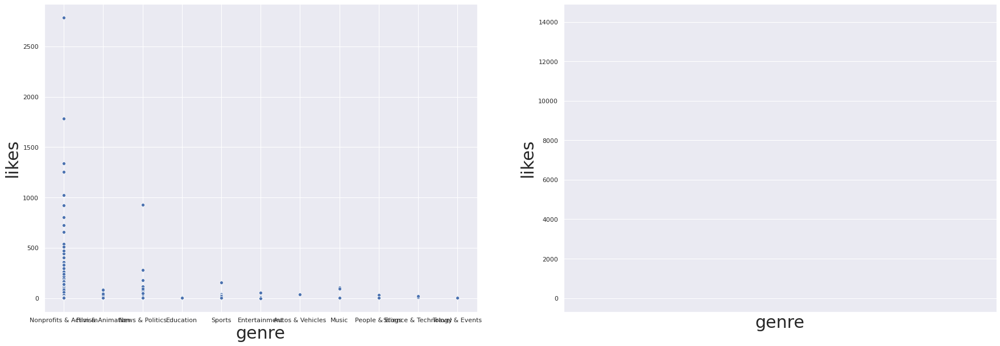

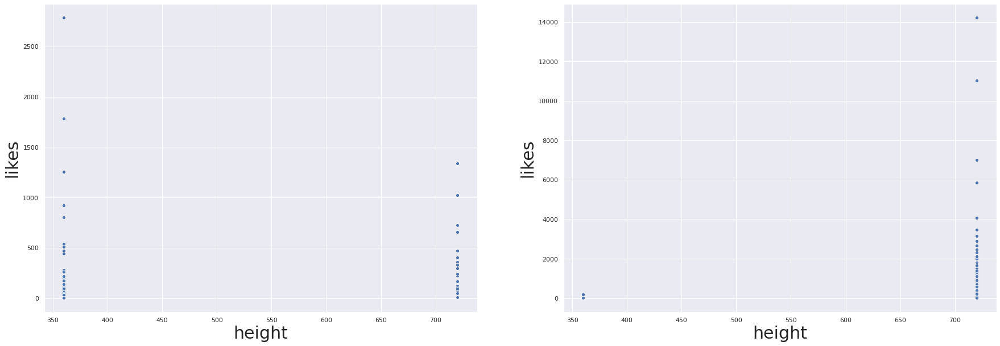

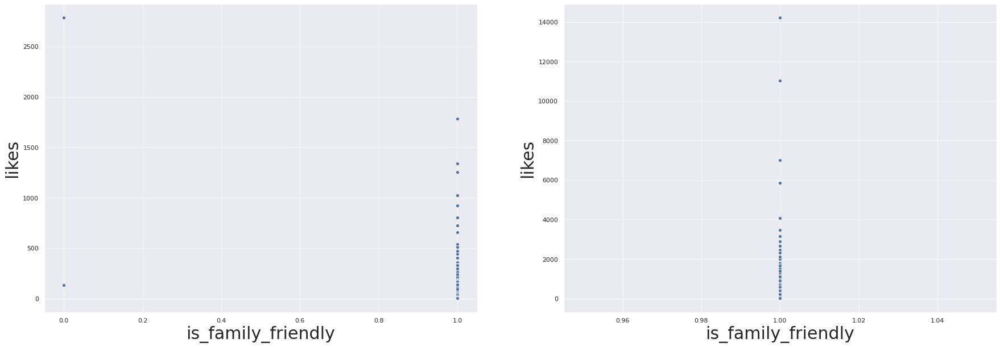

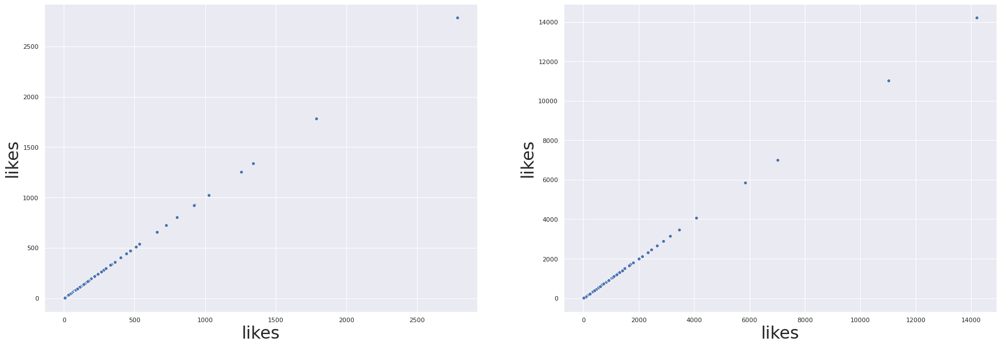

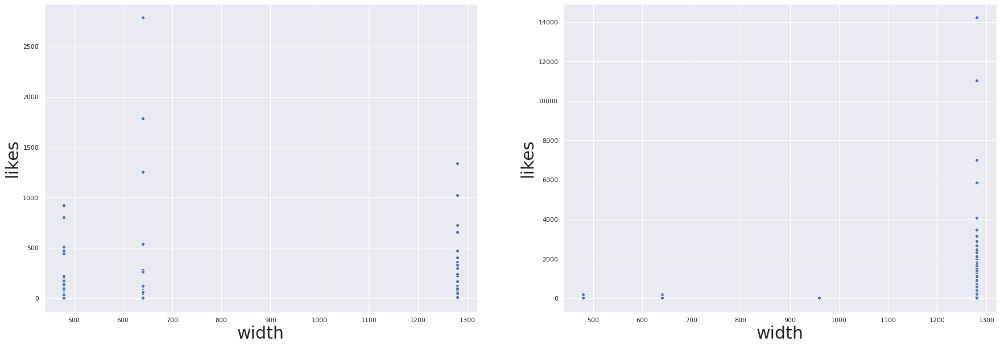

...

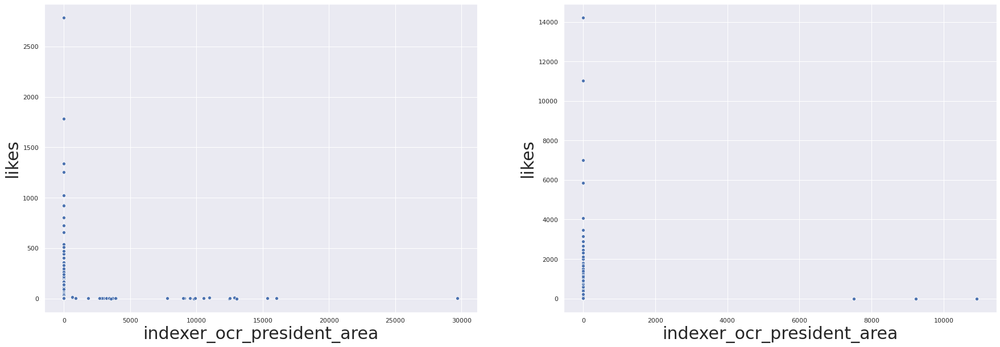

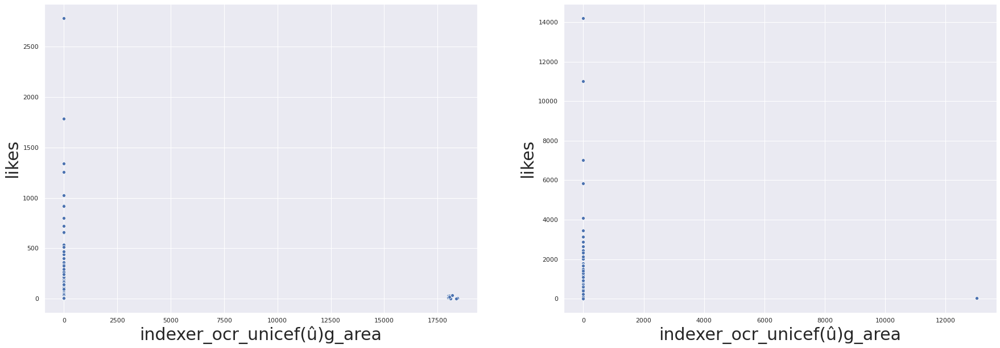

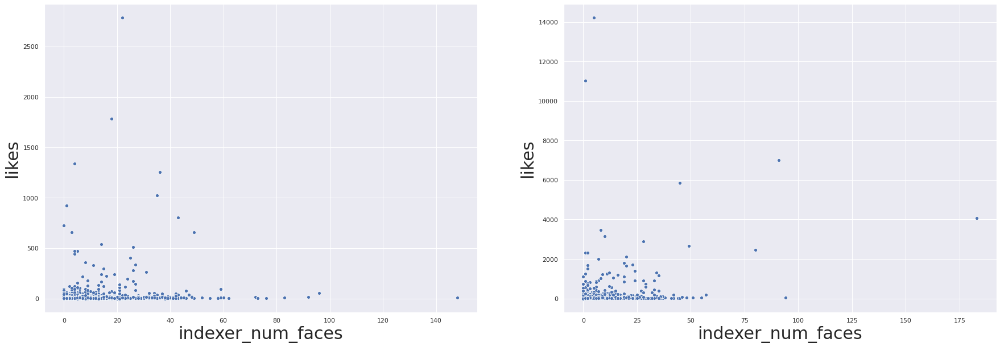

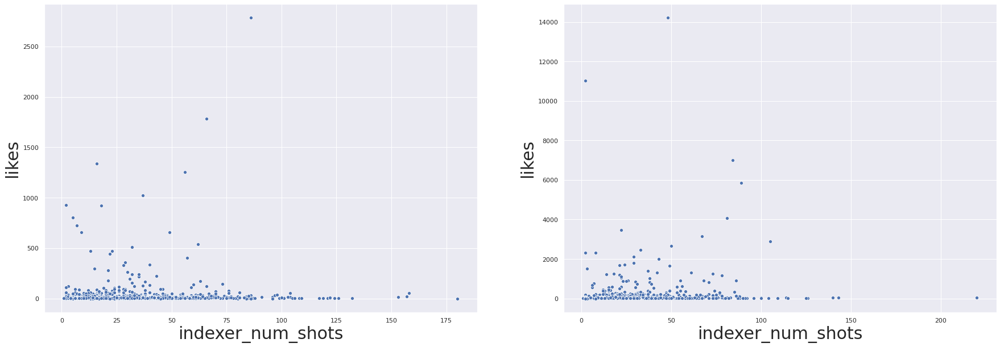

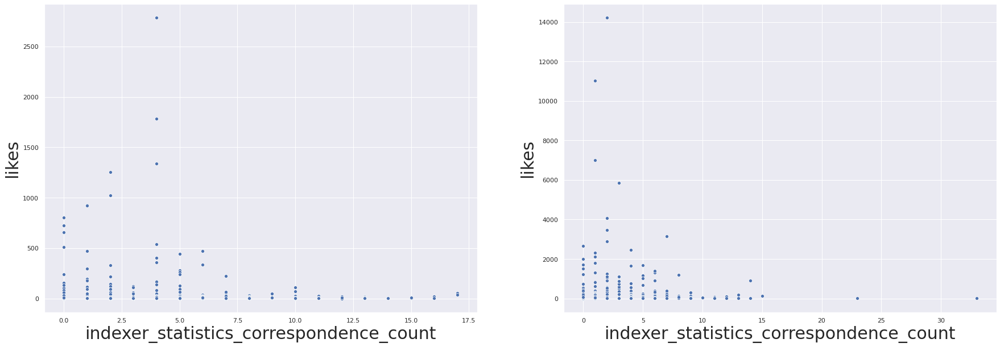

In [ ]:
for cols in videos_before_2013.columns:
  fig,ax=plt.subplots(1,2,figsize=(30,10))
  sns.scatterplot(x=videos_before_2013[cols], y=videos_before_2013['likes'], ax=ax[0])
  ax[0].set_xlabel(r'{}'.format(cols),fontsize=30)
  ax[0].set_ylabel('likes',fontsize=30)

  sns.scatterplot(x=videos_after_2013[cols], y=videos_after_2013['likes'], ax=ax[1])
  ax[1].set_xlabel(r'{}'.format(cols),fontsize=30)
  ax[1].set_ylabel('likes',fontsize=30)


In [ ]:
p_values=pd.DataFrame({'after_2013_p':results_after_2013.pvalues<0.05, 'before_2013_p':results_before_2013.pvalues<0.05})
p_values=p_values.drop('const',axis=0)
p_values_sorted=p_values.reindex(p_values.sort_values(by=['before_2013_p', 'after_2013_p']).index )
#p_values_sorted=p_values.reindex(p_values['before_2013_p'].sort_values().index )
p_values_sorted.style.bar(subset = ["after_2013_p","before_2013_p"], color=['#d65f5f', '#5fba7d'])

,after_2013_p,before_2013_p
date_published_day_10,False,False
date_published_day_11,False,False
date_published_day_12,False,False
date_published_day_13,False,False
date_published_day_14,False,False
date_published_day_15,False,False
date_published_day_16,False,False
date_published_day_17,False,False
date_published_day_18,False,False
date_published_day_19,False,False


**Before 2013-** The 'likes' were influenced by tags like aids, health, developement, rights, world, were more likely followed.


**After 2013-** tags related celebrities gets more influenced to likes, If there are celebrity or brands name like FC barcelona, topics like business, dating and relationships, govt ngos, social works etc got much more influenced.

Both are influenced by tags poverty. 
Tags play an important role in getting the number of videos likes. Its like after 2013 likes are titled to tags celebrity and profit, which can be visualized from above graph.

Before 2013, as you can see in graph, profit, celebrity and likes was not a big concern. with 0 celebrity, and 0 profit (with no tags) there were high likes but after 2013, with celbrity and profit (tags likes increased) As you can see a outlier in profit were graph in after 2013 were it crosses likes 14000 and without profit tags it lies between 10000 and 12000 likes. Note- increasing celebrity doesnt increase in likes. 


There should be Tag Unicef, As we can see Without tag Unicef there are not much likes, while with a tag unicef the likes are increased.(fram scatter plot)


Lastly, as we can see from our plot, before 2013 genre was most foccused area, after 2013genre doesnt matter for the likes.
Genre played a major role before 2013 not after 2013